<a href="https://colab.research.google.com/github/IKJHGF/final_assignment/blob/main/final_assignment_20230527_2_DEF_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

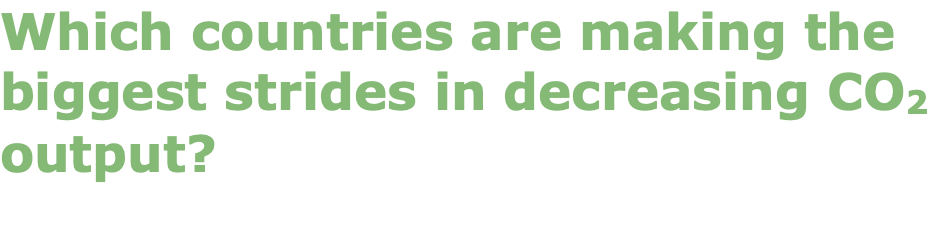

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
%reload_ext google.colab.data_table

df = pd.read_csv("/content/drive/MyDrive/kaya-identity-co2.csv", encoding='utf-8') #read in csv file

In [ ]:
df.drop(['Code', '417485-annotations', 'Annual CO₂ emissions per GDP (kg per international-$)'], axis=1, inplace=True) # drop unuseful columns
df

,Entity,Year,Primary energy consumption per GDP (kWh/$),GDP per capita,Population (historical estimates),Annual CO₂ emissions,Annual CO₂ emissions per unit energy (kg per kilowatt-hour)
0,Afghanistan,1965,NaN,1290.0000,9565154.0,1006917.0,NaN
1,Afghanistan,1966,NaN,1272.0000,9783153.0,1091159.0,NaN
2,Afghanistan,1967,NaN,1277.0000,10010037.0,1281865.0,NaN
3,Afghanistan,1968,NaN,1290.0000,10247782.0,1223391.0,NaN
4,Afghanistan,1969,NaN,1278.0000,10494491.0,941232.0,NaN
...,...,...,...,...,...,...,...
15987,Zimbabwe,2017,2.092965,1582.3662,14751101.0,9596071.0,0.208901
15988,Zimbabwe,2018,2.091188,1611.4052,15052191.0,11795478.0,0.248315
15989,Zimbabwe,2019,NaN,NaN,15354606.0,11114607.0,0.224871
15990,Zimbabwe,2020,NaN,NaN,15669663.0,10607897.0,NaN


In [ ]:
df.rename(columns = {'Entity': 'Country', 'Population (historical estimates)': 'Population', 
                     'Primary energy consumption per GDP (kWh/$)': 'Annual_energy_intensity', 
                     'GDP per capita': 'GDP_per_capita', 'Annual CO₂ emissions': 'Annual_CO2_emissions',
                     'Annual CO₂ emissions per unit energy (kg per kilowatt-hour)': 'Annual_carbon_intensity'
                     }, inplace = True) # more readable and useable column names
df

,Country,Year,Annual_energy_intensity,GDP_per_capita,Population,Annual_CO2_emissions,Annual_carbon_intensity
0,Afghanistan,1965,NaN,1290.0000,9565154.0,1006917.0,NaN
1,Afghanistan,1966,NaN,1272.0000,9783153.0,1091159.0,NaN
2,Afghanistan,1967,NaN,1277.0000,10010037.0,1281865.0,NaN
3,Afghanistan,1968,NaN,1290.0000,10247782.0,1223391.0,NaN
4,Afghanistan,1969,NaN,1278.0000,10494491.0,941232.0,NaN
...,...,...,...,...,...,...,...
15987,Zimbabwe,2017,2.092965,1582.3662,14751101.0,9596071.0,0.208901
15988,Zimbabwe,2018,2.091188,1611.4052,15052191.0,11795478.0,0.248315
15989,Zimbabwe,2019,NaN,NaN,15354606.0,11114607.0,0.224871
15990,Zimbabwe,2020,NaN,NaN,15669663.0,10607897.0,NaN


In [ ]:
not_countries = ['Africa', 'Africa (GCP)', 'Africa (UN)', 'Akrotiri and Dhekelia',
                 'American Samoa', 'Antarctica', 'Asia', 'Asia (GCP)', 'Asia (UN)',
                 'Asia (excl. China and India)', 'Cayman Islands', 'Central America (GCP)',
                 'Christmas Island', 'Czechoslovakia', 'East Asia', 'Eastern Europe',
                 'East Germany', 'Eritrea and Ethiopia', 'Europe', 'Europe (GCP)',
                 'Europe (UN)', 'Europe (excl. EU-27)', 'Europe (excl. EU-28)',
                 'European Union (27)', 'European Union (27) (GCP)',
                 'European Union (28)', 'Falkland Islands', 'Former Sudan',
                 'Gibraltar', 'Guam', 'Guernsey', 'High-income countries', 
                 'International transport', 'Isle of Man', 'Jersey', 
                 'Kuwaiti Oil Fires (GCP)', 'Latin America',
                 'Latin America and the Caribbean (UN)', 'Low-income countries', 
                 'Lower-middle-income countries', 'Middle East', 'Middle East (GCP)',
                 'Monaco', 'Netherlands Antilles', 'Non-OECD (GCP)', 'North America',
                 'North America (GCP)', 'North America (excl. USA)', 'Northern America (UN)',
                 'Northern Mariana Islands', 'OECD (GCP)', 'Oceania', 'Oceania (GCP)',
                 'Oceania (UN)', 'Panama Canal Zone (GCP)', 'Puerto Rico',
                 'Ryukyu Islands (GCP)', 'Saint Barthlemy', 'Saint Martin (French part)',
                 'San Marino', 'Serbia and Montenegro', 'South America',
                 'South America (GCP)', 'South and South-East Asia',
                 'St. Kitts-Nevis-Anguilla (GCP)', 'Sub-Sahara Africa',
                 'Svalbard and Jan Mayen', 'Tokelau', 'United States Virgin Islands',
                 'USSR', 'Upper-middle-income countries', 'Vatican', 'Wallis and Futuna', 
                 'West Germany', 'Western Europe', 'Western Offshoots', 'Western Sahara',
                 'World', 'Yemen Arab Republic', "Yemen People's Republic", 'Yugoslavia'
                 ]
df = df[df.Country.isin(not_countries) == False].reset_index(drop=True) # drop rows that are not a country or do not have values in 'Annual CO2 Emissions' or that do not have values in all years from 1965 until 2021
df

,Country,Year,Annual_energy_intensity,GDP_per_capita,Population,Annual_CO2_emissions,Annual_carbon_intensity
0,Afghanistan,1965,NaN,1290.0000,9565154.0,1006917.0,NaN
1,Afghanistan,1966,NaN,1272.0000,9783153.0,1091159.0,NaN
2,Afghanistan,1967,NaN,1277.0000,10010037.0,1281865.0,NaN
3,Afghanistan,1968,NaN,1290.0000,10247782.0,1223391.0,NaN
4,Afghanistan,1969,NaN,1278.0000,10494491.0,941232.0,NaN
...,...,...,...,...,...,...,...
12421,Zimbabwe,2017,2.092965,1582.3662,14751101.0,9596071.0,0.208901
12422,Zimbabwe,2018,2.091188,1611.4052,15052191.0,11795478.0,0.248315
12423,Zimbabwe,2019,NaN,NaN,15354606.0,11114607.0,0.224871
12424,Zimbabwe,2020,NaN,NaN,15669663.0,10607897.0,NaN


In [ ]:
print(df['Country'].unique())

['Afghanistan' 'Albania' 'Algeria' 'Andorra' 'Angola' 'Anguilla'
 'Antigua and Barbuda' 'Argentina' 'Armenia' 'Aruba' 'Australia' 'Austria'
 'Azerbaijan' 'Bahamas' 'Bahrain' 'Bangladesh' 'Barbados' 'Belarus'
 'Belgium' 'Belize' 'Benin' 'Bermuda' 'Bhutan' 'Bolivia'
 'Bonaire Sint Eustatius and Saba' 'Bosnia and Herzegovina' 'Botswana'
 'Brazil' 'British Virgin Islands' 'Brunei' 'Bulgaria' 'Burkina Faso'
 'Burundi' 'Cambodia' 'Cameroon' 'Canada' 'Cape Verde'
 'Central African Republic' 'Chad' 'Chile' 'China' 'Colombia' 'Comoros'
 'Congo' 'Cook Islands' 'Costa Rica' "Cote d'Ivoire" 'Croatia' 'Cuba'
 'Curacao' 'Cyprus' 'Czechia' 'Democratic Republic of Congo' 'Denmark'
 'Djibouti' 'Dominica' 'Dominican Republic' 'Ecuador' 'Egypt'
 'El Salvador' 'Equatorial Guinea' 'Eritrea' 'Estonia' 'Eswatini'
 'Ethiopia' 'Faeroe Islands' 'Fiji' 'Finland' 'France' 'French Guiana'
 'French Polynesia' 'Gabon' 'Gambia' 'Georgia' 'Germany' 'Ghana' 'Greece'
 'Greenland' 'Grenada' 'Guadeloupe' 'Guatemala' 'Guin

In [ ]:
countries = ['Afghanistan', 'Albania', 'Algeria', 'Andorra', 'Angola', 'Anguilla',
             'Antigua and Barbuda', 'Argentina', 'Armenia', 'Aruba', 'Australia', 
             'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh', 'Barbados',
             'Belarus','Belgium', 'Belize', 'Benin', 'Bermuda', 'Bhutan', 'Bolivia',
             'Bonaire Sint Eustatius and Saba', 'Bosnia and Herzegovina', 'Botswana',
             'Brazil', 'British Virgin Islands', 'Brunei', 'Bulgaria', 'Burkina Faso',
             'Burundi', 'Cambodia', 'Cameroon', 'Canada', 'Cape Verde',
             'Central African Republic', 'Chad', 'Chile', 'China', 'Colombia',
             'Comoros', 'Congo', 'Cook Islands', 'Costa Rica', "Cote d'Ivoire",
             'Croatia', 'Cuba', 'Curacao', 'Cyprus', 'Czechia',
             'Democratic Republic of Congo', 'Denmark', 'Djibouti', 'Dominica',
             'Dominican Republic', 'Ecuador', 'Egypt', 'El Salvador',
             'Equatorial Guinea', 'Eritrea', 'Estonia', 'Eswatini', 'Ethiopia',
             'Faeroe Islands', 'Fiji', 'Finland', 'France', 'French Guiana',
             'French Polynesia', 'Gabon', 'Gambia', 'Georgia', 'Germany', 'Ghana',
             'Greece', 'Greenland', 'Grenada', 'Guadeloupe', 'Guatemala', 'Guinea',
             'Guinea-Bissau', 'Guyana', 'Haiti', 'Honduras', 'Hong Kong', 'Hungary',
             'Iceland', 'India', 'Indonesia', 'Iran', 'Iraq', 'Ireland', 'Israel',
             'Italy', 'Jamaica', 'Japan', 'Jordan', 'Kazakhstan', 'Kenya',
             'Kiribati', 'Kosovo', 'Kuwait', 'Kyrgyzstan', 'Laos', 'Latvia',
             'Lebanon', 'Lesotho', 'Liberia', 'Libya', 'Liechtenstein', 'Lithuania',
             'Luxembourg', 'Macao', 'Madagascar', 'Malawi', 'Malaysia', 'Maldives', 
             'Mali', 'Malta', 'Marshall Islands', 'Martinique', 'Mauritania',
             'Mauritius', 'Mayotte', 'Mexico', 'Micronesia (country)', 'Moldova',
             'Mongolia', 'Montenegro', 'Montserrat', 'Morocco', 'Mozambique',
             'Myanmar', 'Namibia', 'Nauru', 'Nepal', 'Netherlands', 'New Caledonia',
             'New Zealand', 'Nicaragua', 'Niger', 'Nigeria', 'Niue', 'North Korea',
             'North Macedonia', 'Norway', 'Oman', 'Pakistan', 'Palau', 'Palestine',
             'Panama', 'Papua New Guinea', 'Paraguay', 'Peru', 'Philippines',
             'Poland', 'Portugal', 'Qatar', 'Reunion', 'Romania', 'Russia', 'Rwanda',
             'Saint Helena', 'Saint Kitts and Nevis', 'Saint Lucia',
             'Saint Pierre and Miquelon', 'Saint Vincent and the Grenadines',
             'Samoa', 'Sao Tome and Principe', 'Saudi Arabia', 'Senegal', 'Serbia',
             'Seychelles', 'Sierra Leone', 'Singapore', 'Sint Maarten (Dutch part)',
             'Slovakia', 'Slovenia', 'Solomon Islands', 'Somalia', 'South Africa',
             'South Korea', 'South Sudan', 'Spain', 'Sri Lanka', 'Sudan', 'Suriname',
             'Sweden', 'Switzerland', 'Syria', 'Taiwan', 'Tajikistan', 'Tanzania',
             'Thailand', 'Timor', 'Togo', 'Tonga', 'Trinidad and Tobago', 'Tunisia',
             'Turkey', 'Turkmenistan', 'Turks and Caicos Islands', 'Tuvalu', 'Uganda',
             'Ukraine', 'United Arab Emirates', 'United Kingdom', 'United States',
             'Uruguay', 'Uzbekistan', 'Vanuatu', 'Venezuela', 'Vietnam', 'Yemen', 
             'Zambia', 'Zimbabwe']
#df['Country'].nunique()

In [ ]:
df['Year'].astype(int)
#df.dtypes

0        1965
1        1966
2        1967
3        1968
4        1969
         ... 
12421    2017
12422    2018
12423    2019
12424    2020
12425    2021
Name: Year, Length: 12426, dtype: int64

In [ ]:
df['CO2_per_capita'] = df['Annual_CO2_emissions'] / df['Population'] # add new column with CO2 emissions per capita
df

,Country,Year,Annual_energy_intensity,GDP_per_capita,Population,Annual_CO2_emissions,Annual_carbon_intensity,CO2_per_capita
0,Afghanistan,1965,NaN,1290.0000,9565154.0,1006917.0,NaN,0.105269
1,Afghanistan,1966,NaN,1272.0000,9783153.0,1091159.0,NaN,0.111534
2,Afghanistan,1967,NaN,1277.0000,10010037.0,1281865.0,NaN,0.128058
3,Afghanistan,1968,NaN,1290.0000,10247782.0,1223391.0,NaN,0.119381
4,Afghanistan,1969,NaN,1278.0000,10494491.0,941232.0,NaN,0.089688
...,...,...,...,...,...,...,...,...
12421,Zimbabwe,2017,2.092965,1582.3662,14751101.0,9596071.0,0.208901,0.650533
12422,Zimbabwe,2018,2.091188,1611.4052,15052191.0,11795478.0,0.248315,0.783639
12423,Zimbabwe,2019,NaN,NaN,15354606.0,11114607.0,0.224871,0.723861
12424,Zimbabwe,2020,NaN,NaN,15669663.0,10607897.0,NaN,0.676970


In [ ]:
df_twocentury_mask = df.loc[(df['Year'] == 1965) | (df['Year'] == 2021)]
df_twocentury_mask

,Country,Year,Annual_energy_intensity,GDP_per_capita,Population,Annual_CO2_emissions,Annual_carbon_intensity,CO2_per_capita
0,Afghanistan,1965,NaN,1290.0,9565154.0,1006917.0,NaN,0.105269
56,Afghanistan,2021,NaN,NaN,40099460.0,11874211.0,NaN,0.296119
57,Albania,1965,NaN,2670.0,2009793.0,2172159.0,NaN,1.080787
113,Albania,2021,NaN,NaN,2854710.0,4619109.0,NaN,1.618066
114,Algeria,1965,0.696334,2981.0,12381262.0,6588533.0,0.265317,0.532137
...,...,...,...,...,...,...,...,...
12311,Yemen,2021,NaN,NaN,32981644.0,12476597.0,NaN,0.378289
12312,Zambia,1965,NaN,1828.0,3658035.0,3912261.0,NaN,1.069498
12368,Zambia,2021,NaN,NaN,19473132.0,7676180.0,NaN,0.394193
12369,Zimbabwe,1965,NaN,1568.0,4447152.0,5209198.0,NaN,1.171356


In [ ]:
df_twocentury_mask['CO2_per_capita_diff'] = df_twocentury_mask.groupby(['Country'])['CO2_per_capita'].diff() # calculate difference between CO2 per capita in 1965 and 2021
df_twocentury_mask

<ipython-input-36-d0533d62fa77>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_twocentury_mask['CO2_per_capita_diff'] = df_twocentury_mask.groupby(['Country'])['CO2_per_capita'].diff() # calculate difference between CO2 per capita in 1965 and 2021


,Country,Year,Annual_energy_intensity,GDP_per_capita,Population,Annual_CO2_emissions,Annual_carbon_intensity,CO2_per_capita,CO2_per_capita_diff
0,Afghanistan,1965,NaN,1290.0,9565154.0,1006917.0,NaN,0.105269,NaN
56,Afghanistan,2021,NaN,NaN,40099460.0,11874211.0,NaN,0.296119,0.190850
57,Albania,1965,NaN,2670.0,2009793.0,2172159.0,NaN,1.080787,NaN
113,Albania,2021,NaN,NaN,2854710.0,4619109.0,NaN,1.618066,0.537279
114,Algeria,1965,0.696334,2981.0,12381262.0,6588533.0,0.265317,0.532137,NaN
...,...,...,...,...,...,...,...,...,...
12311,Yemen,2021,NaN,NaN,32981644.0,12476597.0,NaN,0.378289,-0.265899
12312,Zambia,1965,NaN,1828.0,3658035.0,3912261.0,NaN,1.069498,NaN
12368,Zambia,2021,NaN,NaN,19473132.0,7676180.0,NaN,0.394193,-0.675305
12369,Zimbabwe,1965,NaN,1568.0,4447152.0,5209198.0,NaN,1.171356,NaN


In [ ]:
df0 = df_twocentury_mask[df_twocentury_mask['CO2_per_capita_diff']<0]
df0.sort_values('CO2_per_capita_diff').iloc[:5]

,Country,Year,Annual_energy_intensity,GDP_per_capita,Population,Annual_CO2_emissions,Annual_carbon_intensity,CO2_per_capita,CO2_per_capita_diff
10145,Sint Maarten (Dutch part),2021,NaN,NaN,44061.0,647902.0,NaN,14.704659,-237.480464
9119,Qatar,2021,NaN,NaN,2688239.0,95667180.0,0.178707,35.587305,-61.352580
2849,Curacao,2021,NaN,NaN,190348.0,1843765.0,NaN,9.686285,-52.983931
5927,Kuwait,2021,NaN,NaN,4250111.0,106134264.0,0.219728,24.972116,-43.901646
6497,Luxembourg,2021,NaN,NaN,639330.0,8354555.0,0.198505,13.067672,-23.903704


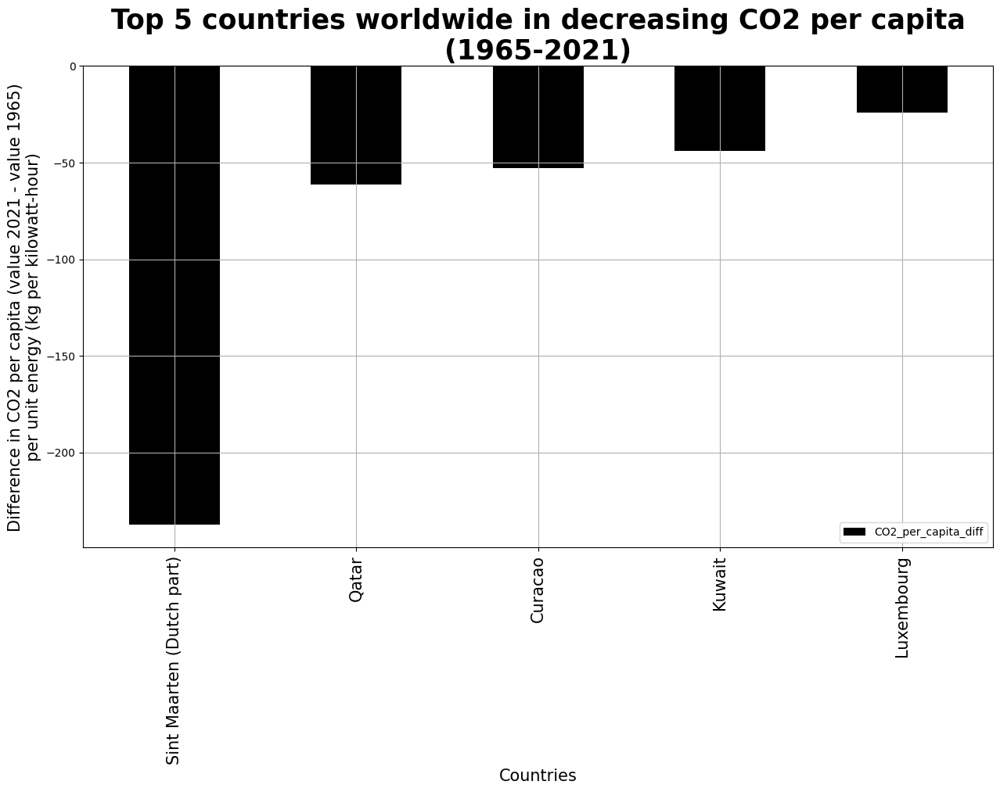

In [ ]:
df0.sort_values('CO2_per_capita_diff').iloc[:5].plot(x='Country', y='CO2_per_capita_diff', kind='bar', figsize=(15, 8), color='black')
plt.xticks(rotation='vertical')
plt.xlabel("Countries", fontsize=15)
plt.ylabel("Difference in CO2 per capita (value 2021 - value 1965)\nper unit energy (kg per kilowatt-hour)", fontsize=15)
plt.xticks(fontsize=15)
plt.grid(visible=True)
plt.title("Top 5 countries worldwide in decreasing CO2 per capita\n(1965-2021)", fontsize=25, fontweight='bold')
plt.show()

In [ ]:
df_century_mask = df.loc[(df['Year'] == 2000) | (df['Year'] == 2021)]
df_century_mask

,Country,Year,Annual_energy_intensity,GDP_per_capita,Population,Annual_CO2_emissions,Annual_carbon_intensity,CO2_per_capita
35,Afghanistan,2000,0.524080,502.3727,19542986.0,1047127.94,0.177071,0.053581
56,Afghanistan,2021,NaN,NaN,40099460.0,11874211.00,NaN,0.296119
92,Albania,2000,1.888485,4808.4795,3182027.0,3024926.00,0.105281,0.950629
113,Albania,2021,NaN,NaN,2854710.0,4619109.00,NaN,1.618066
149,Algeria,2000,1.438215,6834.5537,30774624.0,82221010.00,0.274120,2.671715
...,...,...,...,...,...,...,...,...
12311,Yemen,2021,NaN,NaN,32981644.0,12476597.00,NaN,0.378289
12347,Zambia,2000,1.950826,1428.5024,9891140.0,1784113.00,0.061116,0.180375
12368,Zambia,2021,NaN,NaN,19473132.0,7676180.00,NaN,0.394193
12404,Zimbabwe,2000,2.175267,2211.1963,11834679.0,13818202.00,0.237341,1.167603


In [ ]:
df_century_mask['CO2_per_capita_diff'] = df_century_mask.groupby(['Country'])['CO2_per_capita'].diff() # calculate difference between CO2 per capita in 2000 and 2021
df_century_mask

<ipython-input-40-fb59193f9abe>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_century_mask['CO2_per_capita_diff'] = df_century_mask.groupby(['Country'])['CO2_per_capita'].diff() # calculate difference between CO2 per capita in 2000 and 2021


,Country,Year,Annual_energy_intensity,GDP_per_capita,Population,Annual_CO2_emissions,Annual_carbon_intensity,CO2_per_capita,CO2_per_capita_diff
35,Afghanistan,2000,0.524080,502.3727,19542986.0,1047127.94,0.177071,0.053581,NaN
56,Afghanistan,2021,NaN,NaN,40099460.0,11874211.00,NaN,0.296119,0.242538
92,Albania,2000,1.888485,4808.4795,3182027.0,3024926.00,0.105281,0.950629,NaN
113,Albania,2021,NaN,NaN,2854710.0,4619109.00,NaN,1.618066,0.667437
149,Algeria,2000,1.438215,6834.5537,30774624.0,82221010.00,0.274120,2.671715,NaN
...,...,...,...,...,...,...,...,...,...
12311,Yemen,2021,NaN,NaN,32981644.0,12476597.00,NaN,0.378289,-0.399741
12347,Zambia,2000,1.950826,1428.5024,9891140.0,1784113.00,0.061116,0.180375,NaN
12368,Zambia,2021,NaN,NaN,19473132.0,7676180.00,NaN,0.394193,0.213819
12404,Zimbabwe,2000,2.175267,2211.1963,11834679.0,13818202.00,0.237341,1.167603,NaN


In [ ]:
df1 = df_century_mask[df_century_mask['CO2_per_capita_diff']<0]
df1.sort_values('CO2_per_capita_diff').iloc[:5]

,Country,Year,Annual_energy_intensity,GDP_per_capita,Population,Annual_CO2_emissions,Annual_carbon_intensity,CO2_per_capita,CO2_per_capita_diff
2849,Curacao,2021,NaN,NaN,190348.0,1843765.0,NaN,9.686285,-25.298400
569,Aruba,2021,NaN,NaN,106543.0,858126.0,NaN,8.054269,-18.629035
9119,Qatar,2021,NaN,NaN,2688239.0,95667180.0,0.178707,35.587305,-17.066737
11855,United Arab Emirates,2021,NaN,NaN,9365149.0,204086660.0,0.162244,21.792142,-12.337789
6497,Luxembourg,2021,NaN,NaN,639330.0,8354555.0,0.198505,13.067672,-6.926091


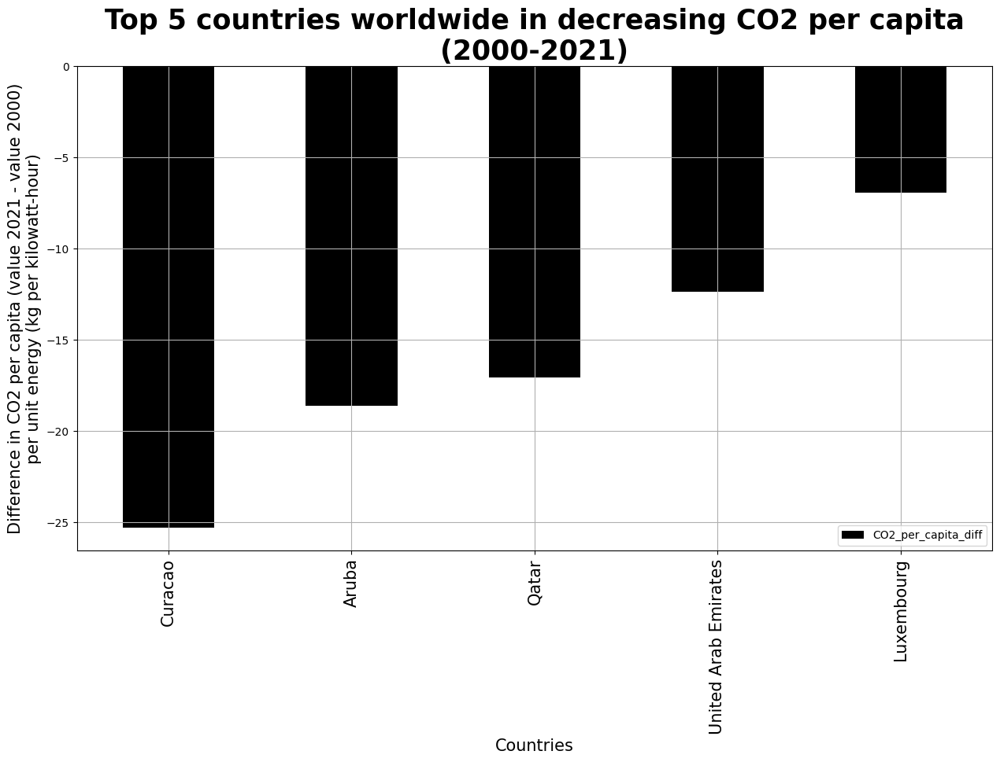

In [ ]:
df1.sort_values('CO2_per_capita_diff').iloc[:5].plot(x='Country', y='CO2_per_capita_diff', kind='bar', figsize=(15, 8), color='black')
plt.xticks(rotation='vertical')
plt.xlabel("Countries", fontsize=15)
plt.ylabel("Difference in CO2 per capita (value 2021 - value 2000)\nper unit energy (kg per kilowatt-hour)", fontsize=15)
plt.xticks(fontsize=15)
plt.grid(visible=True)
plt.title("Top 5 countries worldwide in decreasing CO2 per capita\n(2000-2021)", fontsize=25, fontweight='bold')
plt.show()

In [ ]:
df_decade_mask = df.loc[(df['Year'] == 2011) | (df['Year'] == 2021)]
df_decade_mask

,Country,Year,Annual_energy_intensity,GDP_per_capita,Population,Annual_CO2_emissions,Annual_carbon_intensity,CO2_per_capita
46,Afghanistan,2011,0.885104,1792.0,29249156.0,11838316.0,0.250815,0.404740
56,Afghanistan,2021,NaN,NaN,40099460.0,11874211.0,NaN,0.296119
103,Albania,2011,1.106598,9484.0,2900660.0,5314676.0,0.168797,1.832230
113,Albania,2021,NaN,NaN,2854710.0,4619109.0,NaN,1.618066
160,Algeria,2011,0.963599,13204.0,36543548.0,119807544.0,0.257934,3.278487
...,...,...,...,...,...,...,...,...
12311,Yemen,2021,NaN,NaN,32981644.0,12476597.0,NaN,0.378289
12358,Zambia,2011,0.947439,3205.0,14265824.0,3372367.0,0.078847,0.236395
12368,Zambia,2021,NaN,NaN,19473132.0,7676180.0,NaN,0.394193
12415,Zimbabwe,2011,2.571834,1515.0,13025789.0,10363199.0,0.206069,0.795591


In [ ]:
df_decade_mask['CO2_per_capita_diff'] = df_decade_mask.groupby(['Country'])['CO2_per_capita'].diff() # calculate difference between CO2 per capita in 2000 and 2021
df_decade_mask

<ipython-input-44-3b65ac13c33a>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_decade_mask['CO2_per_capita_diff'] = df_decade_mask.groupby(['Country'])['CO2_per_capita'].diff() # calculate difference between CO2 per capita in 2000 and 2021


,Country,Year,Annual_energy_intensity,GDP_per_capita,Population,Annual_CO2_emissions,Annual_carbon_intensity,CO2_per_capita,CO2_per_capita_diff
46,Afghanistan,2011,0.885104,1792.0,29249156.0,11838316.0,0.250815,0.404740,NaN
56,Afghanistan,2021,NaN,NaN,40099460.0,11874211.0,NaN,0.296119,-0.108621
103,Albania,2011,1.106598,9484.0,2900660.0,5314676.0,0.168797,1.832230,NaN
113,Albania,2021,NaN,NaN,2854710.0,4619109.0,NaN,1.618066,-0.214164
160,Algeria,2011,0.963599,13204.0,36543548.0,119807544.0,0.257934,3.278487,NaN
...,...,...,...,...,...,...,...,...,...
12311,Yemen,2021,NaN,NaN,32981644.0,12476597.0,NaN,0.378289,-0.414241
12358,Zambia,2011,0.947439,3205.0,14265824.0,3372367.0,0.078847,0.236395,NaN
12368,Zambia,2021,NaN,NaN,19473132.0,7676180.0,NaN,0.394193,0.157799
12415,Zimbabwe,2011,2.571834,1515.0,13025789.0,10363199.0,0.206069,0.795591,NaN


In [ ]:
df2 = df_decade_mask[df_decade_mask['CO2_per_capita_diff']<0]
df2.sort_values('CO2_per_capita_diff').iloc[:5]

,Country,Year,Annual_energy_intensity,GDP_per_capita,Population,Annual_CO2_emissions,Annual_carbon_intensity,CO2_per_capita,CO2_per_capita_diff
2849,Curacao,2021,NaN,NaN,190348.0,1843765.0,NaN,9.686285,-22.036509
569,Aruba,2021,NaN,NaN,106543.0,858126.0,NaN,8.054269,-16.612555
11399,Trinidad and Tobago,2021,NaN,NaN,1525671.0,36124040.0,0.211605,23.677477,-9.195341
9119,Qatar,2021,NaN,NaN,2688239.0,95667180.0,0.178707,35.587305,-8.559001
6497,Luxembourg,2021,NaN,NaN,639330.0,8354555.0,0.198505,13.067672,-8.358049


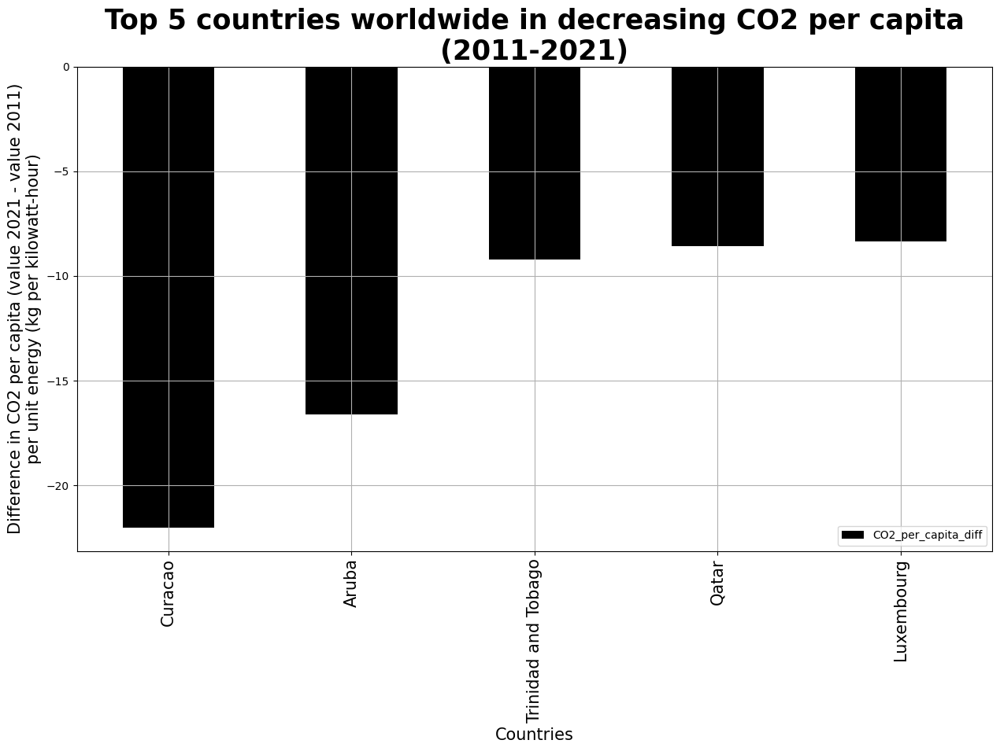

In [ ]:
df2.sort_values('CO2_per_capita_diff').iloc[:5].plot(x='Country', y='CO2_per_capita_diff', kind='bar', figsize=(15, 8), color='black')
plt.xticks(rotation='vertical')
plt.xlabel("Countries", fontsize=15)
plt.ylabel("Difference in CO2 per capita (value 2021 - value 2011)\nper unit energy (kg per kilowatt-hour)", fontsize=15)
plt.xticks(fontsize=15)
plt.grid(visible=True)
plt.title("Top 5 countries worldwide in decreasing CO2 per capita\n(2011-2021)", fontsize=25, fontweight='bold')
plt.show()

In [ ]:
decreased_co2 = df0.sort_values(['CO2_per_capita_diff', 'Country'], ascending=[True,True]).iloc[:35]
decreased_co2_top35 = decreased_co2
decreased_co2_top35

,Country,Year,Annual_energy_intensity,GDP_per_capita,Population,Annual_CO2_emissions,Annual_carbon_intensity,CO2_per_capita,CO2_per_capita_diff
10145,Sint Maarten (Dutch part),2021,NaN,NaN,44061.0,6.479020e+05,NaN,14.704659,-237.480464
9119,Qatar,2021,NaN,NaN,2688239.0,9.566718e+07,0.178707,35.587305,-61.352580
2849,Curacao,2021,NaN,NaN,190348.0,1.843765e+06,NaN,9.686285,-52.983931
5927,Kuwait,2021,NaN,NaN,4250111.0,1.061343e+08,0.219728,24.972116,-43.901646
6497,Luxembourg,2021,NaN,NaN,639330.0,8.354555e+06,0.198505,13.067672,-23.903704
1424,Bonaire Sint Eustatius and Saba,2021,NaN,NaN,26730.0,1.033890e+05,NaN,3.867901,-11.144566
3590,Estonia,2021,NaN,NaN,1328704.0,1.044902e+07,0.158609,7.864070,-6.946055
11912,United Kingdom,2021,NaN,NaN,67281040.0,3.467732e+08,0.173884,5.154100,-6.317716
10829,Sweden,2021,NaN,NaN,10467095.0,3.584895e+07,0.056507,3.424919,-4.641632
4274,Germany,2021,NaN,NaN,83408560.0,6.747535e+08,0.192151,8.089740,-4.536960


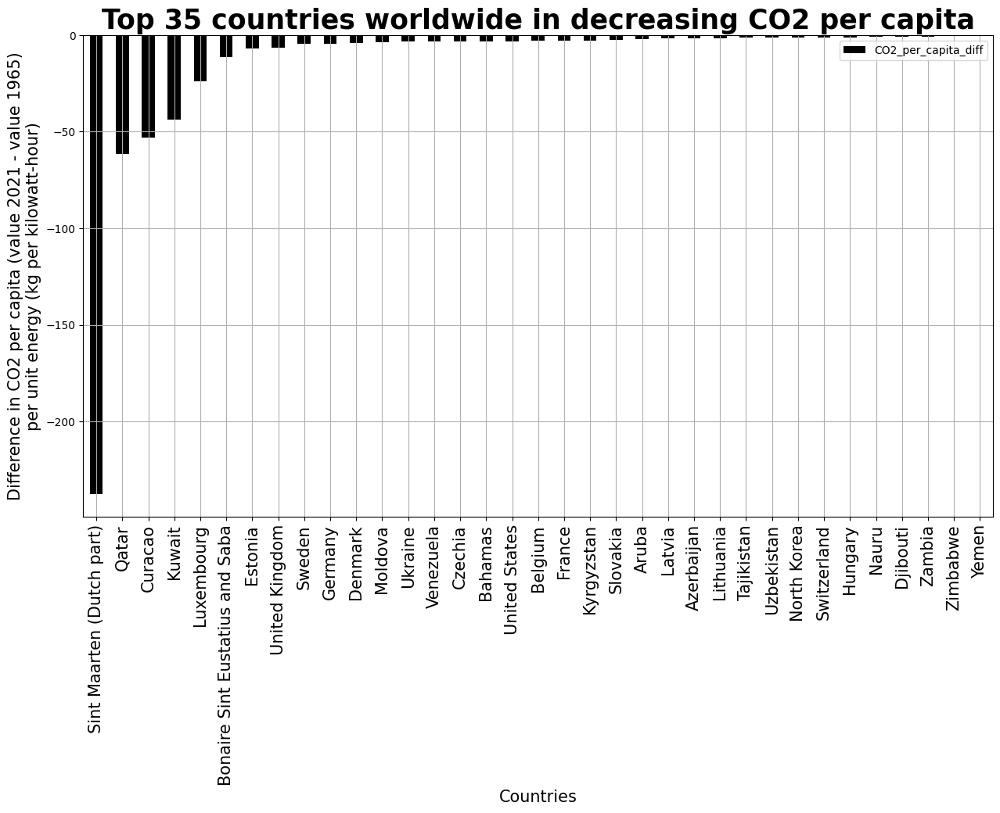

In [ ]:
decreased_co2_top35.plot(x='Country', y='CO2_per_capita_diff', kind='bar', figsize=(15, 8), color='black')
#plt.rcParams['axes.grid'] = True
plt.xticks(rotation='vertical')
plt.xlabel("Countries", fontsize=15)
plt.ylabel("Difference in CO2 per capita (value 2021 - value 1965)\nper unit energy (kg per kilowatt-hour)", fontsize=15)
plt.xticks(fontsize=15)
plt.grid(visible=True)
plt.title("Top 35 countries worldwide in decreasing CO2 per capita", fontsize=25, fontweight='bold')
plt.show()

In [ ]:
x = ['Sint Maarten (Dutch part)', 'Qatar', 'Curacao', 'Kuwait','Luxembourg',
     'Bonaire Sint Eustatius and Saba', 'Estonia', 'United Kingdom', 'Sweden',
     'Germany', 'Denmark', 'Moldova', 'Ukraine', 'Venezuela', 'Czechia',
     'Bahamas', 'United States', 'Belgium', 'France', 'Kyrgyzstan', 'Slovakia',
     'Aruba', 'Latvia', 'Azerbaijan', 'Lithuania', 'Tajikistan', 'Uzbekistan',
     'North Korea', 'Switzerland', 'Hungary', 'Nauru', 'Djibouti', 'Zambia', 
     'Zimbabwe', 'Yemen']

In [ ]:
decreased_co2_top35['Country'].unique()

array(['Sint Maarten (Dutch part)', 'Qatar', 'Curacao', 'Kuwait',
       'Luxembourg', 'Bonaire Sint Eustatius and Saba', 'Estonia',
       'United Kingdom', 'Sweden', 'Germany', 'Denmark', 'Moldova',
       'Ukraine', 'Venezuela', 'Czechia', 'Bahamas', 'United States',
       'Belgium', 'France', 'Kyrgyzstan', 'Slovakia', 'Aruba', 'Latvia',
       'Azerbaijan', 'Lithuania', 'Tajikistan', 'Uzbekistan',
       'North Korea', 'Switzerland', 'Hungary', 'Nauru', 'Djibouti',
       'Zambia', 'Zimbabwe', 'Yemen'], dtype=object)

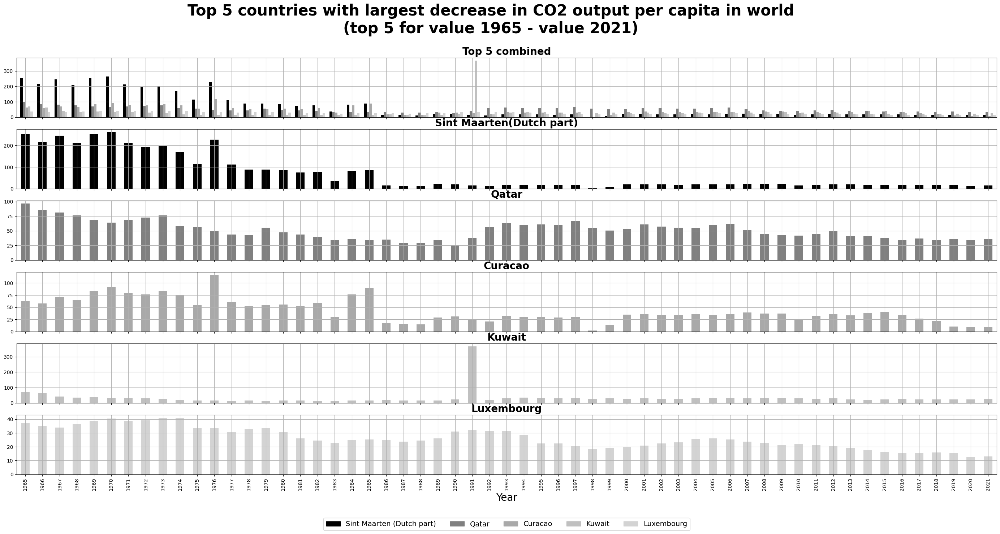

In [ ]:
df.set_index('Year', inplace=True)
df_sintmaarten = df.loc[df['Country'] == 'Sint Maarten (Dutch part)']
df_sintmaarten
df_qatar = df.loc[df['Country'] == 'Qatar']
df_qatar
df_curacao = df.loc[df['Country'] == 'Curacao']
df_curacao
df_kuwait = df.loc[df['Country'] == 'Kuwait']
df_kuwait
df_luxembourg = df.loc[df['Country'] == 'Luxembourg']
df_luxembourg

plt.rcParams['axes.grid'] = True

fig, axes = plt.subplots(nrows=6, ncols=1, sharex=True)
fig.set_figwidth(35)
fig.set_figheight(15)
import matplotlib.colors as mcolors
import matplotlib.patches as mpatches

df1 = df_sintmaarten['CO2_per_capita']
df1a = df_qatar['CO2_per_capita']
df1b = df_curacao['CO2_per_capita']
df1c = df_kuwait['CO2_per_capita']
df1d = df_luxembourg['CO2_per_capita']

df1.plot(ax=axes[0], kind="bar", color = 'black', width = 0.15, position = +2.0)
df1a.plot(ax=axes[0], kind="bar", color = 'grey', width = 0.15, position = +1.0)
df1b.plot(ax=axes[0], kind="bar", color = 'darkgrey', width = 0.15, position= 0)
df1c.plot(ax=axes[0], kind="bar", color = 'silver', width = 0.15, position= -1.0)
df1d.plot(ax=axes[0], kind="bar", color = 'lightgrey', width = 0.15, position= -2.0)

df1.plot(ax=axes[1], kind="bar", color = 'black', width = 0.5)
df1a.plot(ax=axes[2], kind="bar", color = 'grey', width = 0.5)
df1b.plot(ax=axes[3], kind="bar", color = 'darkgrey', width = 0.5)
df1c.plot(ax=axes[4], kind="bar", color = 'silver', width = 0.5)
df1d.plot(ax=axes[5], kind="bar", color = 'lightgrey', width = 0.5)

fig.suptitle('Top 5 countries with largest decrease in CO2 output per capita in world\n(top 5 for value 1965 - value 2021)', fontsize=30, fontweight='bold')
black_patch = mpatches.Patch(color='black', label='Sint Maarten (Dutch part)')
grey_patch = mpatches.Patch(color='grey', label='Qatar')
darkgrey_patch = mpatches.Patch(color='darkgrey', label='Curacao')
silver_patch = mpatches.Patch(color='silver', label='Kuwait')
lightgrey_patch = mpatches.Patch(color='lightgrey', label='Luxembourg')

axes[0].set_title('Top 5 combined', fontsize=20, fontweight='bold')
axes[1].set_title('Sint Maarten(Dutch part)', fontsize=20, fontweight='bold')
axes[2].set_title('Qatar', fontsize=20, fontweight='bold')
axes[3].set_title('Curacao', fontsize=20, fontweight='bold')
axes[4].set_title('Kuwait', fontsize=20, fontweight='bold')
axes[5].set_title('Luxembourg', fontsize=20, fontweight='bold')
plt.legend(loc='lower center', ncol=5, bbox_to_anchor=(0.5, -1), fontsize = 14, handles=[black_patch, grey_patch, darkgrey_patch, silver_patch, lightgrey_patch])
plt.xlabel('Year', fontsize=20)

plt.show()